# UFO Sightings

### Group 11: Zhe Li, Matthew Samach
## ----------------------------------------------------------

## I. Data Preprocessing

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
from IPython.display import Image
import numpy as np
import warnings
from datetime import datetime
import re
import geopandas as gpd
import os
from matplotlib.colors import LinearSegmentedColormap
warnings.filterwarnings('ignore')

%matplotlib inline

In [2]:
# load the file
ufos_raw = pd.read_csv('ufo_sighting_data.csv')

In [3]:
ufos_raw.head(2)

,Date_time,city,state/province,country,UFO_shape,length_of_encounter_seconds,described_duration_of_encounter,description,date_documented,latitude,longitude
0,10/10/1949 20:30,san marcos,tx,us,cylinder,2700,45 minutes,This event took place in early fall around 194...,4/27/2004,29.8830556,-97.941111
1,10/10/1949 21:00,lackland afb,tx,NaN,light,7200,1-2 hrs,1949 Lackland AFB&#44 TX. Lights racing acros...,12/16/2005,29.38421,-98.581082


In [4]:
# check the data type
ufos_raw.dtypes

Date_time                           object
city                                object
state/province                      object
country                             object
UFO_shape                           object
length_of_encounter_seconds         object
described_duration_of_encounter     object
description                         object
date_documented                     object
latitude                            object
longitude                          float64
dtype: object

In [5]:
ufos = ufos_raw[ufos_raw.Date_time.apply(lambda x: not bool(re.search('24:', x)))]
# change the data type
ufos['encounter_date'] = [datetime.strptime(x, '%m/%d/%Y %H:%M') for x in ufos.Date_time]
ufos['encounter_year'] = ufos.encounter_date.apply(lambda x: x.year)
ufos['encounter_seconds'] = ufos.length_of_encounter_seconds.apply(lambda x: float(re.search('([0-9]*)', str(x)).group(1)))

ufos['latitude'] = ufos.latitude.apply(lambda x: float(re.sub('[^0-9\.]', '', str(x))))

ufos['date_documented_formated'] = [datetime.strptime(x, '%m/%d/%Y') for x in ufos.date_documented]
ufos['state_upper'] = ufos['state/province'].apply(lambda x: x if x != x else x.strip().upper())
ufos['country'] = ufos.country.apply(lambda x: x if x !=x else x.upper())

In [6]:
# show the new data types
ufos.dtypes

Date_time                                  object
city                                       object
state/province                             object
country                                    object
UFO_shape                                  object
length_of_encounter_seconds                object
described_duration_of_encounter            object
description                                object
date_documented                            object
latitude                                  float64
longitude                                 float64
encounter_date                     datetime64[ns]
encounter_year                              int64
encounter_seconds                         float64
date_documented_formated           datetime64[ns]
state_upper                                object
dtype: object

In [7]:
# add a column to clarify which year the UFO was seen in
ufos_raw['year'] = [date[-10:-6] for date in ufos_raw['Date_time']]
# add a column to clarify which decade the UFO was seen in
ufos_raw['decade'] = [int(year[:3]+'0') for year in ufos_raw['year']]
decades = sorted(ufos_raw.decade.unique())
len(decades)

12

## ----------------------------------------------------------
## II. Data Exploration

### Part A. Worldwide UFO Sightings

### VIsualization 1
### UFO Sightings OverTime
This visualizaiton shows how the number of sightings have changed over time.

Text(0, 0.5, '# Sightings')

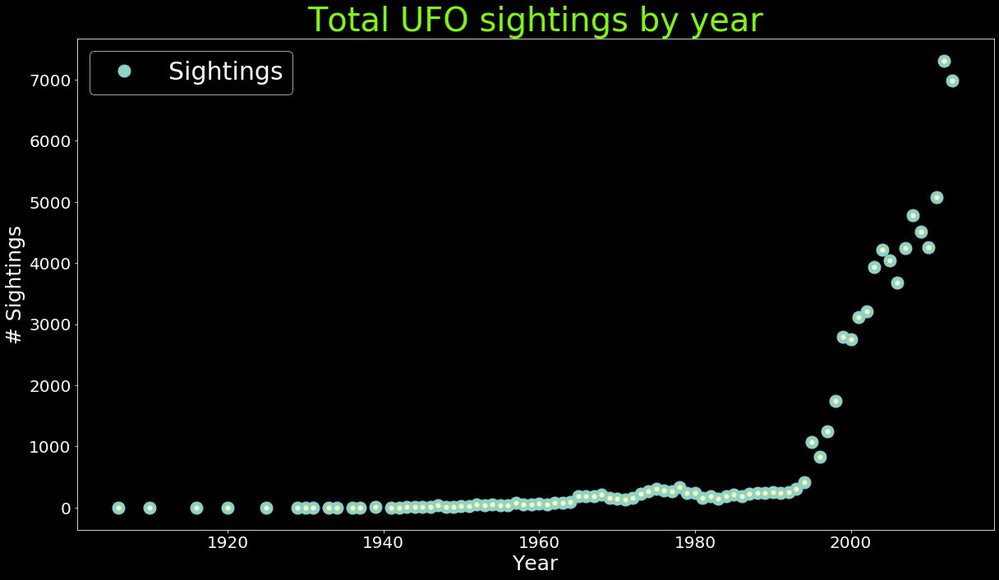

In [8]:
# Filter out 2014 because we don't have full year's data
ufos_filtered = ufos[ufos.encounter_year != 2014]

# Style
plt.style.use('dark_background')

# Aggregate by year
yearly_sightings = ufos_filtered.encounter_year.value_counts()

# Sizing
fig, ax = plt.subplots(1, figsize=(20,11))    

# Axis formatting
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(20)
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(20)   

# Plotting sightings dots
ax.plot(yearly_sightings, 'o', label = 'Sightings', ms=15)
ax.plot(yearly_sightings, 'o', ms=5)

# Legend
plt.legend(loc='upper left', fontsize=30)

# Add titles
plt.title("Total UFO sightings by year", loc='center', fontsize=40, fontweight=5, color='lawngreen')
plt.xlabel("Year", fontsize=25)
plt.ylabel("# Sightings", fontsize=25)

Text(0, 0.5, '# Sightings')

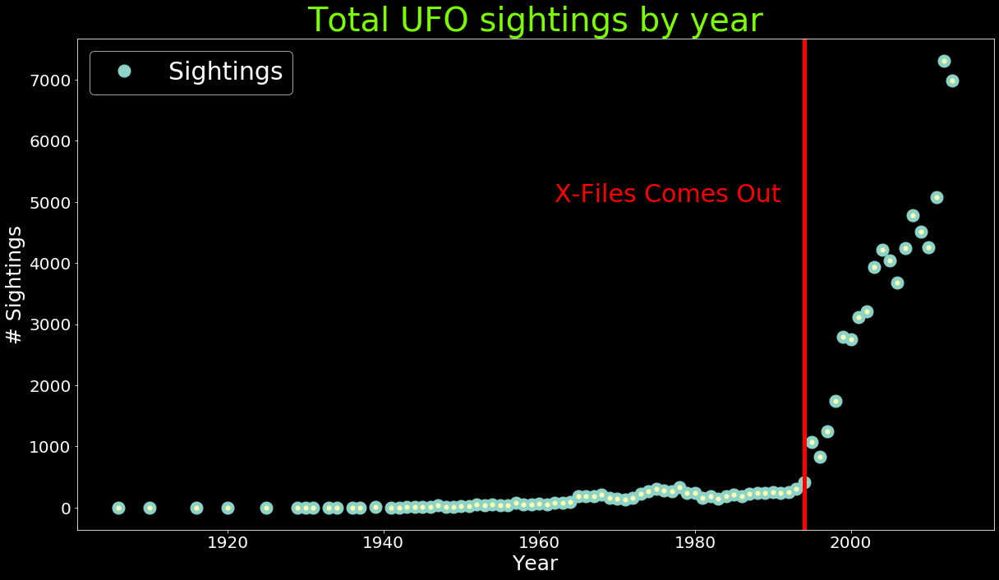

In [9]:
# Sizing
fig, ax = plt.subplots(1, figsize=(20,11))    

# Style
plt.style.use('dark_background')

# Axis formatting
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(20)
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(20)   
    
# Plotting sightings dots
ax.plot(yearly_sightings, 'o', label = 'Sightings', ms=15)
ax.plot(yearly_sightings, 'o', ms=5)

# Plot X-Files line and text
plt.axvline(x=1994, color='red', linewidth=5)

# Legend
plt.legend(loc='upper left', fontsize=30)
plt.text(1962, 5000, 'X-Files Comes Out', horizontalalignment='left',
         color='red', fontsize=30)

# Add titles
plt.title("Total UFO sightings by year", loc='center', fontsize=40, fontweight=5, color='lawngreen')
plt.xlabel("Year", fontsize=25)
plt.ylabel("# Sightings", fontsize=25)

### Visualization 2
### Geographical Distribution of UFO Sightings
This visualization shows the geographical distribution of UFO sightings. The darker the blue areas are, the more events happened in that area.

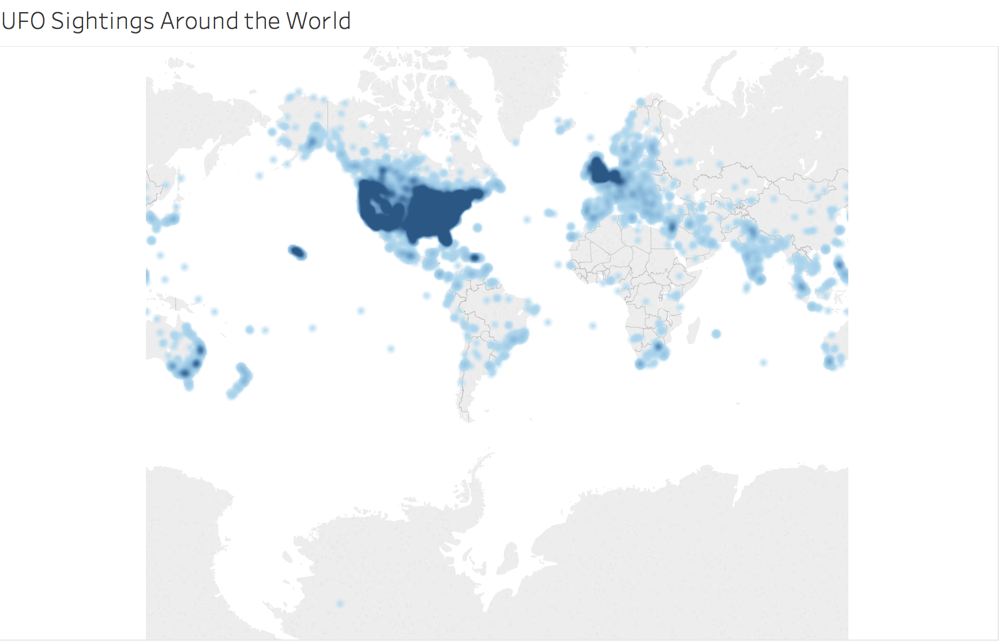

In [10]:
# from Tableau
Image(filename = "tableau/geographical_distribution.png", width=500, height=500)

### Visualization 3
### UFO Shapes Around the World

The following visualization shows for five countries, what the top three most frequent shape of UFOs seen is.

In [11]:
# Data Manipulation before making the visualization

In [12]:
# Make a column that indicates if there is a an entry for UFO shape. Will use this to count.
ufos['has_shape'] = ufos.UFO_shape.apply(lambda x: 0 if x!=x else 1)
shape_counts = ufos.groupby(['country', 'UFO_shape']).count()[['has_shape']]

# Create column that ranks most appearances of each UFO shape in each country
rankings = shape_counts.reset_index().groupby('country').has_shape.rank(ascending=False)
shape_counts.reset_index(inplace=True)
shape_counts['ranking'] = rankings.values

# Filter for only top 3 of each type of shape per country, filter out 'other'
top3 = shape_counts[shape_counts.ranking <= 3.0] 
top3 = top3[top3.UFO_shape != 'other']
top3.head()

,country,UFO_shape,has_shape,ranking
3,AU,circle,61,2.0
8,AU,disk,49,3.0
13,AU,light,117,1.0
24,CA,circle,280,2.0
35,CA,light,652,1.0


In [13]:
# Break the tie in Germany
top3.loc[(top3['country']=='DE') & (top3['UFO_shape']=='fireball'), ['ranking']] = 2.0

# Creating a column with the full name of our countries
top3_dict = {'AU':'Australia', 'CA':'Canada', 'DE':'Germany', 
            'GB':'United Kingdom', 'US':'United States'}
top3['name'] = top3.country.apply(lambda x: top3_dict[x])

# Creating column with the image we will use to represent each shape
shape_dict = {'circle':'○', 'disk':'◎', 'fireball':'☼', 'light':'✧', 'triangle':'△'}
top3['graphic'] = top3.UFO_shape.apply(lambda x: shape_dict[x])
top3.head()

,country,UFO_shape,has_shape,ranking,name,graphic
3,AU,circle,61,2.0,Australia,○
8,AU,disk,49,3.0,Australia,◎
13,AU,light,117,1.0,Australia,✧
24,CA,circle,280,2.0,Canada,○
35,CA,light,652,1.0,Canada,✧


In [14]:
# Grab shape files of all world countries
fp = 'Countries_WGS84/Countries_WGS84.shp'
countries_df = gpd.read_file(fp)

# Grab .csv file that has all world countries centroids in lat, long
centroids = pd.read_csv('country_centroids_az8.csv', usecols= ['name', 'Longitude', 'Latitude'])

# Merge country shape files and centroid file
merged_countries = countries_df.merge(centroids, left_on='CNTRY_NAME', right_on='name')
merged_countries.head(3)

,OBJECTID,CNTRY_NAME,geometry,name,Longitude,Latitude
0,1,Aruba,"POLYGON ((-69.88223 12.41111, -69.94695 12.436...",Aruba,-69.982677,12.520880
1,3,Afghanistan,"POLYGON ((61.27656 35.60725, 61.29638 35.62853...",Afghanistan,66.004734,33.835231
2,4,Algeria,"POLYGON ((-5.15213 30.18047, -5.13917 30.19236...",Algeria,2.617323,28.158938


In [15]:
# Merging Geographic Data and UFO data
ufo_geos = top3.merge(merged_countries, left_on='name', right_on='CNTRY_NAME')
ufo_geos.head(3)

,country,UFO_shape,has_shape,ranking,name_x,graphic,OBJECTID,CNTRY_NAME,geometry,name_y,Longitude,Latitude
0,AU,circle,61,2.0,Australia,○,12,Australia,"MULTIPOLYGON (((142.27997 -10.26556, 142.21053...",Australia,134.491,-25.732887
1,AU,disk,49,3.0,Australia,◎,12,Australia,"MULTIPOLYGON (((142.27997 -10.26556, 142.21053...",Australia,134.491,-25.732887
2,AU,light,117,1.0,Australia,✧,12,Australia,"MULTIPOLYGON (((142.27997 -10.26556, 142.21053...",Australia,134.491,-25.732887


In [16]:
# Separating into 1st, 2nd, and 3rd place dfs to alter latitudes

In [17]:
# We want to do this to stack them on top of each other on the map
first_place = ufo_geos[ufo_geos.ranking==1]
second_place = ufo_geos[ufo_geos.ranking==2]
third_place = ufo_geos[ufo_geos.ranking==3]

second_place['Latitude'] = second_place.Latitude.apply(lambda x: x-5)
third_place['Latitude'] = third_place.Latitude.apply(lambda x: x-10)

geos_df = first_place.append(second_place).append(third_place)

In [18]:
# Lat & Long adjustments for better map clarity
geos_df.loc[geos_df['country']=='US', ['Longitude']] = geos_df.loc[geos_df['country']=='US', ['Longitude']] + 5
geos_df.loc[geos_df['country']=='CA', ['Longitude']] = geos_df.loc[geos_df['country']=='CA', ['Longitude']] - 5
geos_df.loc[geos_df['country']=='CA', ['Latitude']] = geos_df.loc[geos_df['country']=='CA', ['Latitude']] + 2
geos_df.loc[geos_df['country']=='GB', ['Longitude']] = geos_df.loc[geos_df['country']=='GB', ['Longitude']] - 15
geos_df.loc[geos_df['country']=='GB', ['Latitude']] = geos_df.loc[geos_df['country']=='GB', ['Latitude']] + 5
geos_df.loc[geos_df['country']=='DE', ['Longitude']] = geos_df.loc[geos_df['country']=='DE', ['Longitude']] - 11
geos_df.loc[geos_df['country']=='DE', ['Latitude']] = geos_df.loc[geos_df['country']=='DE', ['Latitude']] + 15
geos_df.loc[geos_df['country']=='AU', ['Latitude']] = geos_df.loc[geos_df['country']=='AU', ['Latitude']] + 5
geos_df.loc[geos_df['country']=='AU', ['Longitude']] = geos_df.loc[geos_df['country']=='AU', ['Longitude']] + 2

In [19]:
# Creating a GeoDataFrame of points
country_centroids = gpd.GeoDataFrame(geos_df, 
                                     geometry = gpd.points_from_xy(geos_df.Longitude,
                                                                geos_df.Latitude))

In [23]:
country_centroids

,country,UFO_shape,has_shape,ranking,name_x,graphic,OBJECTID,CNTRY_NAME,geometry,name_y,Longitude,Latitude
2,AU,light,117,1.0,Australia,✧,12,Australia,POINT (136.49100 -20.73289),Australia,136.491000,-20.732887
4,CA,light,652,1.0,Canada,✧,36,Canada,POINT (-103.30777 63.36206),Canada,-103.307770,63.362063
7,DE,light,19,1.0,Germany,✧,88,Germany,POINT (-0.61422 66.10698),Germany,-0.614219,66.106982
10,GB,light,355,1.0,United Kingdom,✧,231,United Kingdom,POINT (-17.86563 59.12387),United Kingdom,-17.865632,59.123872
13,US,light,13409,1.0,United States,✧,233,United States,POINT (-107.46167 45.67955),United States,-107.461674,45.679547
0,AU,circle,61,2.0,Australia,○,12,Australia,POINT (136.49100 -25.73289),Australia,136.491000,-25.732887
3,CA,circle,280,2.0,Canada,○,36,Canada,POINT (-103.30777 58.36206),Canada,-103.307770,58.362063
6,DE,fireball,9,2.0,Germany,☼,88,Germany,POINT (-0.61422 61.10698),Germany,-0.614219,61.106982
9,GB,circle,238,2.0,United Kingdom,○,231,United Kingdom,POINT (-17.86563 54.12387),United Kingdom,-17.865632,54.123872
14,US,triangle,6512,2.0,United States,△,233,United States,POINT (-107.46167 40.67955),United States,-107.461674,40.679547


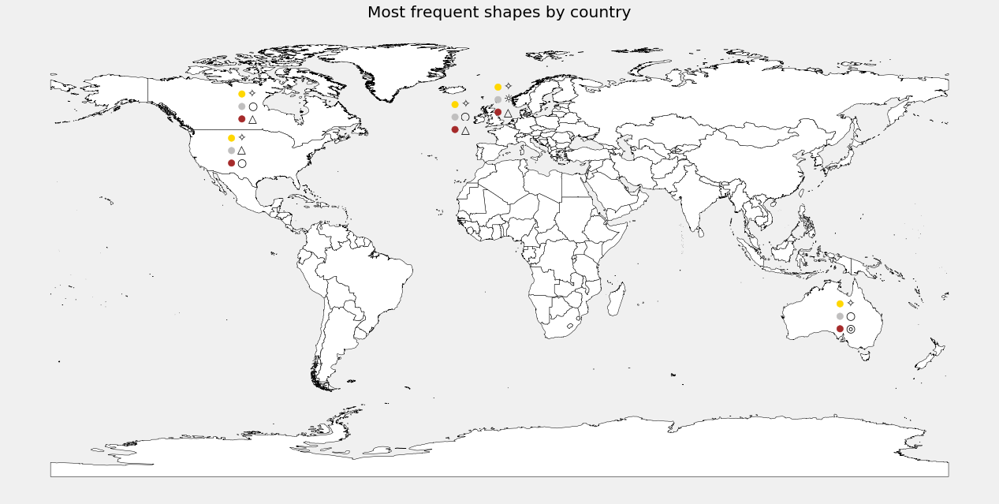

In [25]:
# make the plot
plt.rcParams.update({'font.size': 20})
plt.style.use('fivethirtyeight')

# Giving gold, silver and bronze points
cmap = LinearSegmentedColormap.from_list(
    'mycmap', [(0, 'gold'), (0.5, 'silver'), (1, 'brown')])

# Plot the basemap
ax = countries_df.plot(color='white', edgecolor='black', figsize = (20,20))

# Plotting the points
country_centroids.plot(ax=ax, column='ranking', cmap=cmap, markersize=70, figsize = (20,20))

# Plotting labels, or shapes
for x, y, label in zip(country_centroids.geometry.x, country_centroids.geometry.y, country_centroids.graphic):
    ax.annotate(label, xy=(x, y), xytext=(7, -3), textcoords="offset points", color='black')
    
# remove axis
ax.axis('off')

# Title
ax.set_title('Most frequent shapes by country', color='black')

plt.show()

#### Legend

In [27]:
shape_dict

{'circle': '○', 'disk': '◎', 'fireball': '☼', 'light': '✧', 'triangle': '△'}

### Part B. USA UFO Sightings

### Visualization 4
### UFO Sighting Regions Over Time
This visualization shows the changes of regions where UFOs were seen.

In [28]:
# mapping data manipulation before making visualization

In [29]:
# Important state shape files
fp = 'tl_2019_us_state/tl_2019_us_state.shp'
map_df = gpd.read_file(fp)
map_df.head(3)

,REGION,DIVISION,STATEFP,STATENS,GEOID,STUSPS,NAME,LSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
0,3,5,54,01779805,54,WV,West Virginia,00,G4000,A,62266231560,489271086,+38.6472854,-080.6183274,"POLYGON ((-81.74725 39.09538, -81.74635 39.096..."
1,3,5,12,00294478,12,FL,Florida,00,G4000,A,138947364717,31362872853,+28.4574302,-082.4091477,"MULTIPOLYGON (((-86.38865 30.99418, -86.38385 ..."
2,2,3,17,01779784,17,IL,Illinois,00,G4000,A,143779863817,6215723896,+40.1028754,-089.1526108,"POLYGON ((-91.18529 40.63780, -91.17510 40.643..."


In [30]:
# Remove everything but the lower 48 states
lower48 = map_df[map_df.NAME.isin(['Guam', 'Hawaii', 'Alaska', 'American Samoa',
                                    'United States Virgin Islands', 
                                    'Commonwealth of the Northern Mariana Islands',
                                  'Puerto Rico']).apply(lambda x: not x)]

In [31]:
# Filter out years without at least 100 encounters
year_counts = ufos.groupby('encounter_year').count()['state_upper']
valid_years = year_counts[year_counts >= 100].index
valid_encounters = ufos[ufos.encounter_year.isin(valid_years)]

In [32]:
# Getting total sightings by state and year
ufo_counts = valid_encounters.groupby(['state_upper', 'encounter_year']).count()[['state/province']]
ufo_counts = ufo_counts.rename(columns={'state/province':'sightings'})
ufo_counts.head()

sightings
state_upper encounter_year           
AB          1966                    2
            1967                    2
            1972                    1
            1973                    1
            1978                    3

In [33]:
# Getting total sightings in each year
yearly_totals = ufo_counts.reset_index(level=0)[['sightings']].groupby('encounter_year').sum()
yearly_totals = yearly_totals.rename(columns = {'sightings':'total_sightings'})
yearly_totals.head()

,total_sightings
encounter_year,
1965,176
1966,173
1967,169
1968,200
1969,145


In [34]:
# Adding a column that includes a state's total percent of sightings in a year
ufos_w_total = ufo_counts.reset_index(0).merge(yearly_totals, left_on='encounter_year', right_on='encounter_year')
ufos_w_total['percent'] = ufos_w_total.sightings/ufos_w_total.total_sightings * 100
ufos_percent = ufos_w_total
ufos_percent.head()

,state_upper,sightings,total_sightings,percent
encounter_year,,,,
1966,AB,2,173,1.156069
1966,AK,1,173,0.578035
1966,AL,2,173,1.156069
1966,AR,3,173,1.734104
1966,AZ,1,173,0.578035


In [35]:
# Changing to a pivot so that each row is a state, each column is a year, each value is the percentage
ufo_pivot = pd.pivot_table(ufos_percent, values='percent', columns='encounter_year',
                           index='state_upper')
ufo_pivot.head(3)

encounter_year,1965,1966,1967,1968,1969,1970,1971,1972,1973,1974,...,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014
state_upper,,,,,,,,,,,,,,,,,,,,,
AB,NaN,1.156069,1.183432,NaN,NaN,NaN,NaN,0.714286,0.462963,NaN,...,0.810373,0.454821,0.434227,0.271125,0.318082,0.477507,0.308261,0.242684,0.295858,0.371402
AK,NaN,0.578035,NaN,1.0,2.758621,NaN,NaN,0.714286,0.462963,0.816327,...,0.513236,0.363857,0.153257,0.203344,0.391485,0.301583,0.349363,0.585296,0.665680,1.114206
AL,0.568182,1.156069,2.366864,2.5,1.379310,0.763359,2.654867,2.857143,5.092593,2.040816,...,1.026472,1.091571,1.123883,0.971532,0.734035,0.628299,0.760378,0.785153,1.035503,2.181987


In [36]:
# Merge the lower48 geodataframe to the ufo dataframe
ufo_states = lower48.set_index('STUSPS').join(ufo_pivot)
ufo_states.columns = ufo_states.columns.astype(str)
ufo_states.head(3)

,REGION,DIVISION,STATEFP,STATENS,GEOID,NAME,LSAD,MTFCC,FUNCSTAT,ALAND,...,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014
STUSPS,,,,,,,,,,,,,,,,,,,,,
WV,3,5,54,01779805,54,West Virginia,00,G4000,A,62266231560,...,0.567261,0.485143,0.638570,0.632625,0.758503,0.402111,0.513769,0.842256,0.784024,1.067781
FL,3,5,12,00294478,12,Florida,00,G4000,A,138947364717,...,6.023771,5.821710,6.257982,6.100316,5.725471,5.101784,6.329634,5.881513,7.337278,11.281337
IL,2,3,17,01779784,17,Illinois,00,G4000,A,143779863817,...,5.186386,4.002426,4.265645,3.411658,3.082946,4.699673,4.254007,3.625981,2.307692,1.346332


In [37]:
# Dissolve states up to the divisions level
divisions = ufo_states.dissolve(by='DIVISION', aggfunc='sum')
divisions.head(3)

,geometry,ALAND,AWATER,1965,1966,1967,1968,1969,1970,1971,...,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014
DIVISION,,,,,,,,,,,,,,,,,,,,,
1,"MULTIPOLYGON (((-71.67881 41.15891, -71.67626 ...",162375727568,24072948650,11.363636,5.202312,5.917160,7.0,6.206897,7.633588,10.619469,...,4.484063,4.214676,5.108557,4.767284,5.847810,5.931138,5.713111,7.851535,7.899408,4.410399
2,"POLYGON ((-73.88665 40.48979, -73.88965 40.486...",256979307053,26188555970,19.318182,13.872832,12.426036,12.5,13.103448,19.847328,8.849558,...,8.779038,9.005458,9.118774,10.506100,10.961586,9.801458,10.110974,11.092077,9.659763,7.613742
3,"POLYGON ((-91.18529 40.63780, -91.17510 40.643...",629295323225,151249307182,14.772727,21.965318,12.426036,12.0,13.103448,13.740458,13.274336,...,13.371151,12.310491,13.358876,13.217352,12.087105,14.199548,14.056720,14.232691,14.008876,8.635097


(-127.7471505, -63.987267499999994, 23.146899449999992, 50.63388755)

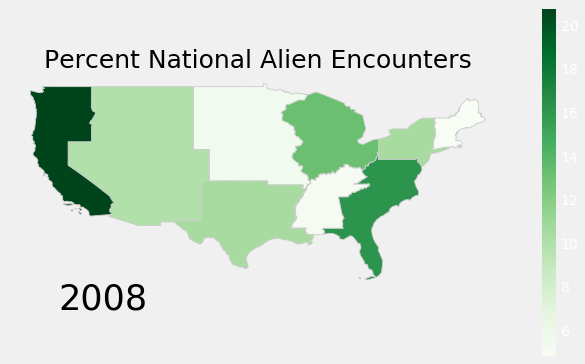

In [47]:
# Testing one version of a map
variable = '2008'
vmin, vmax = 0,20
fig, ax = plt.subplots(1, figsize=(10,6))
divisions.plot(column=variable, cmap='Greens', ax=ax,
               linewidth = 0.8, edgecolor='0.8', legend=True)
ax.set_title('Percent National Alien Encounters',
             color = 'black',
            fontdict = {'fontsize':'25',
                       'fontweight':'3'})
ax.annotate(variable, xy = (0.1, 0.225), 
           xycoords='figure fraction',
           horizontalalignment='left', verticalalignment='top',
           fontsize=35, color = 'black')
ax.axis('off')

Outputting/saving all the images for the .gif

The actual .gif is made by compiling all of the individual images using software called ImageMagick

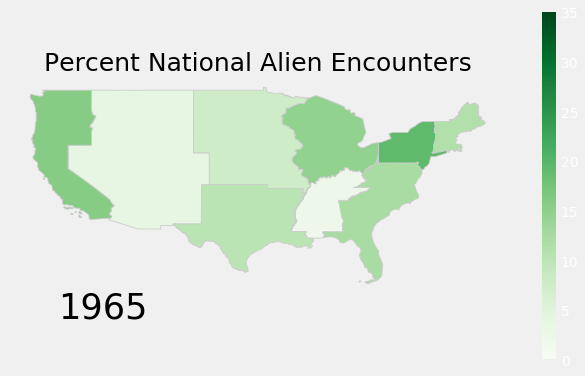

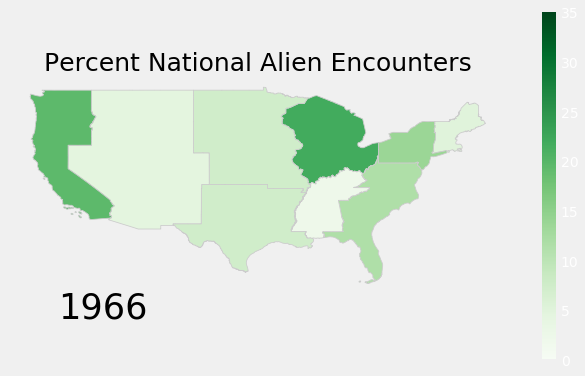

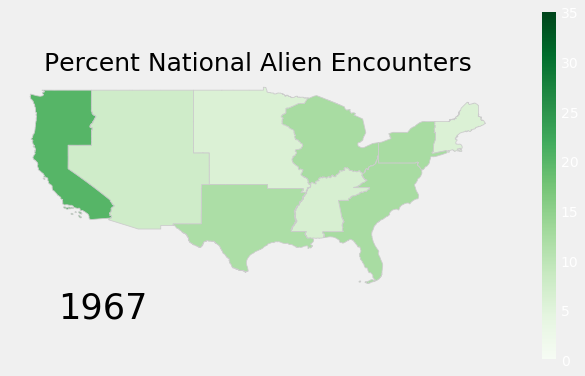

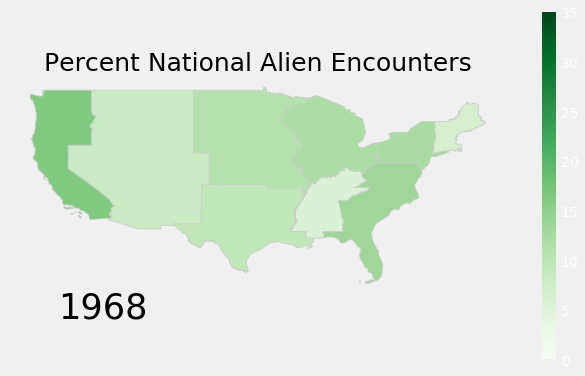

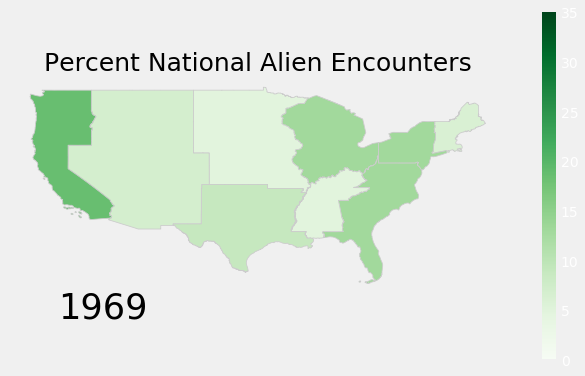

...

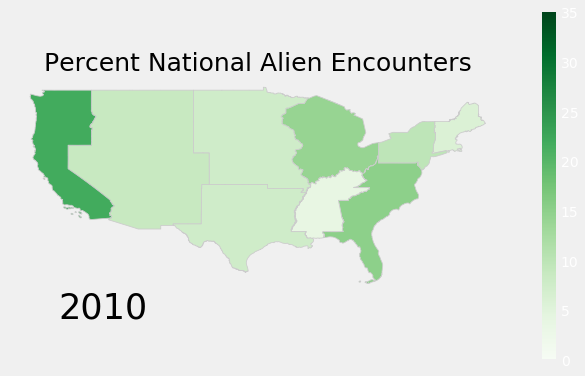

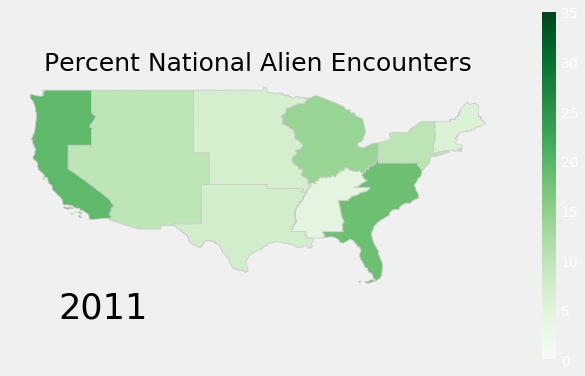

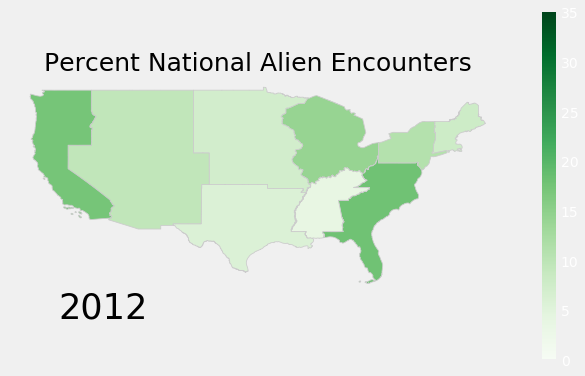

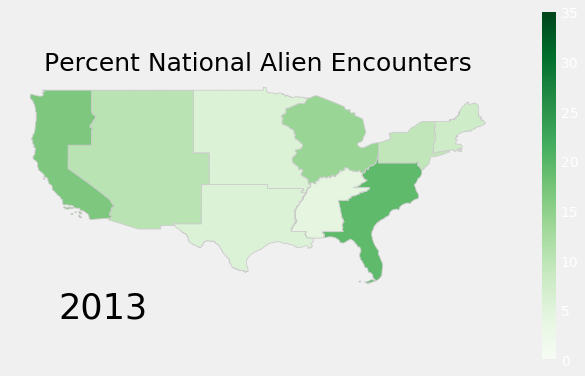

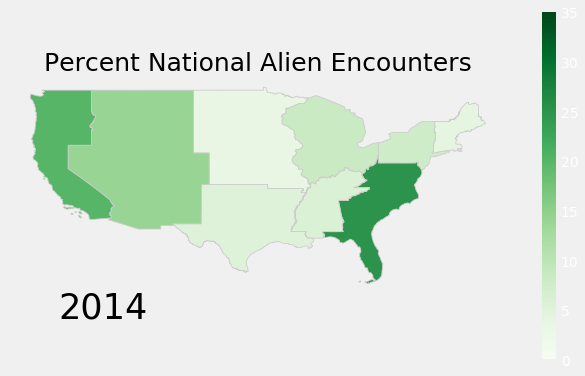

In [48]:
# Doing setup and loop to save charts for each year as .jpg files

output_path = 'time_maps'

# counter for loop
i=0

#1965 to 2014
list_of_years = [str(x) for x in list(range(1965, 2015))]
vmin, vmax = 0, max(divisions.loc[:, '1965':].values.flatten().tolist())

for year in list_of_years:
    # create map
    fig = divisions.plot(column=year, cmap='Greens', figsize=(10,6),
                         linewidth=0.8, edgecolor='0.8', vmin=vmin, vmax=vmax,
                         legend=True, norm=plt.Normalize(vmin=vmin, vmax=vmax))
    # remove axis
    fig.axis('off')
    
    # add title
    fig.set_title('Percent National Alien Encounters',
                  color = 'black',
                  fontdict = {'fontsize':'25',
                       'fontweight':'3'})
    
    # add year to chart
    fig.annotate(year, xy = (0.1, 0.225), 
           xycoords='figure fraction',
           horizontalalignment='left', verticalalignment='top',
           fontsize=35, color = 'black')
    
    # Save figure as high-respng in output path.
    filepath = os.path.join(output_path, year+'_encounters.jpg')
    chart = fig.get_figure()
    chart.savefig(filepath, dpi=300)

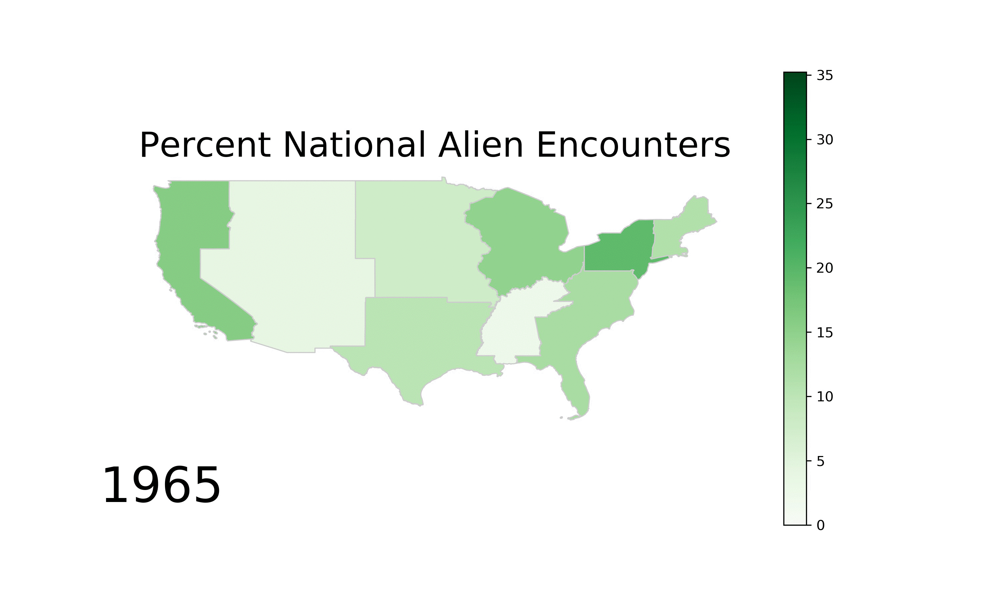

In [50]:
# .gif made from images through terminal. Calling from folder time_maps
Image(filename = "time_maps/encounters_map.gif", width=500, height=500)

### Visualization 5
### Time When UFOs Were Seen in US
The first visualization shows the time of the day UFOs were seen. X axis is the time of day and Y axis is the quantity of UFP sighting events.
The first visualization shows the month in which UFOs were seen. X axis is month and Y axis is the quantity of UFP sighting events.

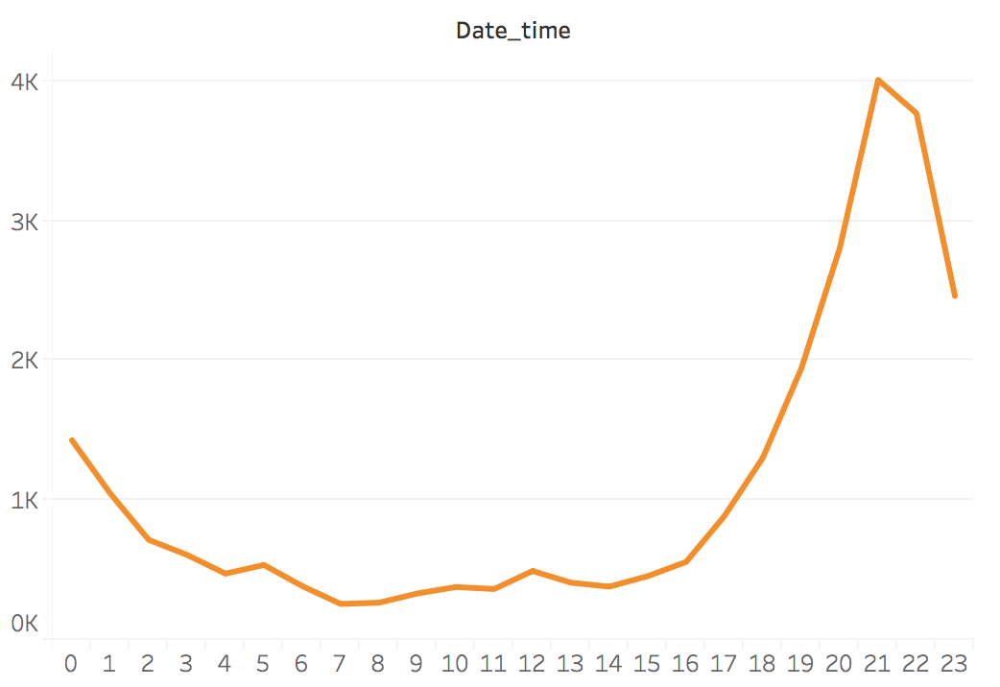

In [51]:
# from Tableau
Image(filename = "tableau/time_of_the_day_UFOs_were_seen_us.png", width=500, height=500)

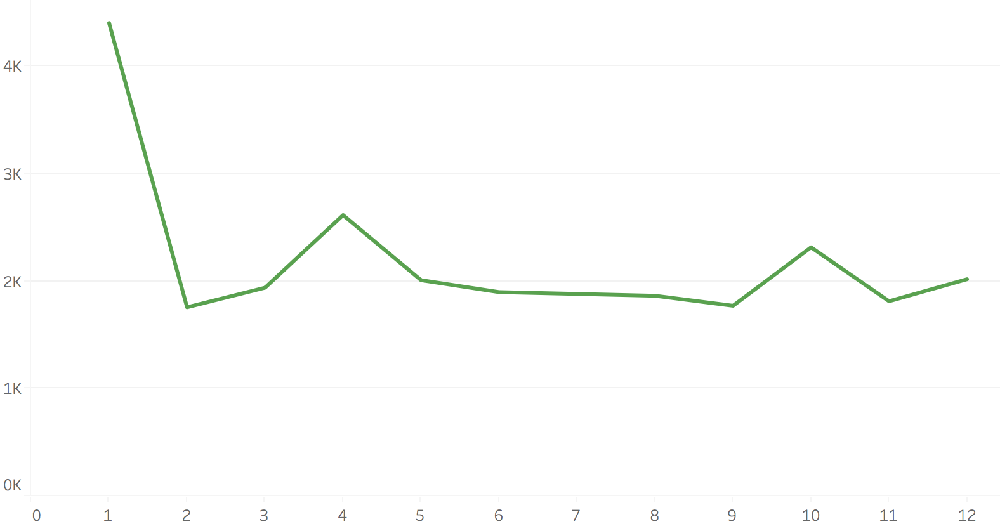

In [52]:
# from Tableau
Image(filename = "tableau/Month_when_UFO_were_seen_us.png", width=500, height=500)

### Visualization 6
### UFO Shapes Over Time
The visualization below shows the quantity of each kind of UFO shapes in US in each year, but considering its readability is not quite high, we use another method to present the UFO shape changes over time.

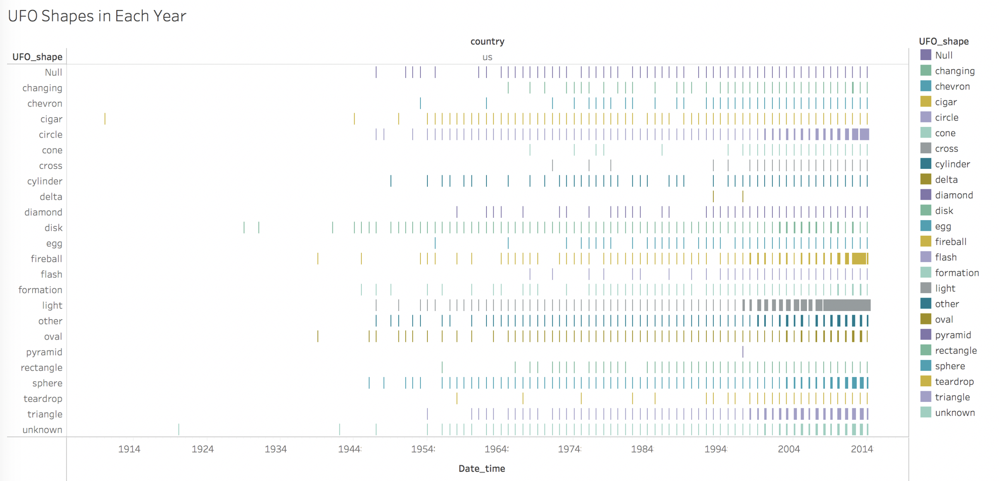

In [53]:
# from Tableau
Image(filename = "tableau/UFO_Shapes_in_Each_Year_us.png", width=800, height=500)

The following charts are our new visualizations to show UFO shapes changes.

In [54]:
# Data manipulation before making the visualizaiton

In [55]:
# Taking only years with at least 50 encounters
year_counts = ufos.encounter_year.value_counts()
eligible_years = list(year_counts[year_counts > 50].index)

In [56]:
filtered_ufos = ufos[ufos.encounter_year.isin(eligible_years)]
filtered_ufos = filtered_ufos[ufos.country=='US']

year_totals = pd.DataFrame(filtered_ufos.groupby('encounter_year')['UFO_shape'].count())
year_totals = year_totals.rename(columns={'UFO_shape':'total_sightings'})

shape_and_year = filtered_ufos.groupby(['encounter_year', 'UFO_shape'])['UFO_shape'].count()
shape_and_year = pd.DataFrame(shape_and_year)

filtered_w_totals = shape_and_year.join(year_totals, on = 'encounter_year')
filtered_w_totals = filtered_w_totals.rename(columns={'UFO_shape':'sightings'})
filtered_w_totals['percent'] = filtered_w_totals.sightings/filtered_w_totals.total_sightings*100

shape_times = filtered_w_totals.reset_index()
shape_times

,encounter_year,UFO_shape,sightings,total_sightings,percent
0,1954,chevron,1,37,2.702703
1,1954,cigar,2,37,5.405405
2,1954,circle,6,37,16.216216
3,1954,cylinder,1,37,2.702703
4,1954,diamond,1,37,2.702703
...,...,...,...,...,...
1045,2014,rectangle,24,1927,1.245459
1046,2014,sphere,163,1927,8.458744
1047,2014,teardrop,13,1927,0.674624
1048,2014,triangle,186,1927,9.652309


In [57]:
# Taking only years with at least 50 encounters
year_counts = ufos.encounter_year.value_counts()
eligible_years = list(year_counts[year_counts > 50].index)

In [58]:
filtered_ufos = ufos[ufos.encounter_year.isin(eligible_years)]
filtered_ufos = filtered_ufos[ufos.country=='US']

year_totals = pd.DataFrame(filtered_ufos.groupby('encounter_year')['UFO_shape'].count())
year_totals = year_totals.rename(columns={'UFO_shape':'total_sightings'})

shape_and_year = filtered_ufos.groupby(['encounter_year', 'UFO_shape'])['UFO_shape'].count()
shape_and_year = pd.DataFrame(shape_and_year)

filtered_w_totals = shape_and_year.join(year_totals, on = 'encounter_year')
filtered_w_totals = filtered_w_totals.rename(columns={'UFO_shape':'sightings'})
filtered_w_totals['percent'] = filtered_w_totals.sightings / filtered_w_totals.total_sightings * 100

shape_times = filtered_w_totals.reset_index()
shape_times

,encounter_year,UFO_shape,sightings,total_sightings,percent
0,1954,chevron,1,37,2.702703
1,1954,cigar,2,37,5.405405
2,1954,circle,6,37,16.216216
3,1954,cylinder,1,37,2.702703
4,1954,diamond,1,37,2.702703
...,...,...,...,...,...
1045,2014,rectangle,24,1927,1.245459
1046,2014,sphere,163,1927,8.458744
1047,2014,teardrop,13,1927,0.674624
1048,2014,triangle,186,1927,9.652309


In [59]:
# Will get only top 7 most popular shapes, cut out 'other'
avg_percent = shape_times.groupby('UFO_shape')['percent'].mean()
avg_percent = avg_percent[(avg_percent.index!='other') & (avg_percent.index!='unknown')]
seven_shapes = avg_percent.sort_values(ascending=False)[:7].index


In [60]:
top_shapes = shape_times[shape_times.UFO_shape.isin(seven_shapes)]

In [61]:
# Pivot table
shape_pivot = pd.DataFrame(pd.pivot_table(top_shapes, values='percent', columns = 'UFO_shape',
                            index = 'encounter_year'))
shape_pivot.head()

UFO_shape,circle,disk,fireball,light,oval,sphere,triangle
encounter_year,,,,,,,
1954,16.216216,35.135135,2.702703,8.108108,8.108108,NaN,2.702703
1957,6.779661,32.203390,3.389831,15.254237,NaN,6.779661,3.389831
1960,12.500000,22.916667,2.083333,4.166667,12.500000,8.333333,2.083333
1962,7.407407,27.777778,NaN,9.259259,3.703704,11.111111,3.703704
1963,6.250000,26.562500,NaN,9.375000,7.812500,6.250000,7.812500


Text(0, 0.5, "Percent of Year's Total Sightings")

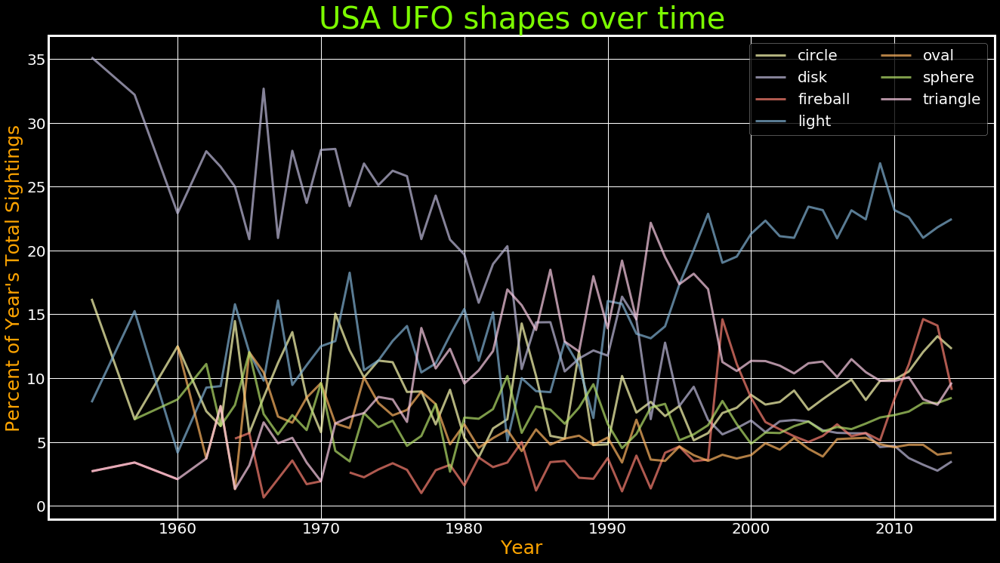

In [62]:
# create a color palette
palette = plt.get_cmap('Set3')
 
plt.style.use('dark_background')

# Sizing
fig, ax = plt.subplots(1, figsize=(20,11))    

# Style
plt.style.use('dark_background')

# Axis formatting
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(20)
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(20)  

# multiple line plot
num=0
for column in shape_pivot.columns:
    num+=1
    plt.plot(shape_pivot.index, shape_pivot[column], color=palette(num), 
            linewidth=3, alpha=0.7, label = column)

plt.legend(loc=1, ncol=2, fontsize=20)  
    
# Add titles
plt.title("USA UFO shapes over time", loc='center', fontsize=40, fontweight=5, color='lawngreen')
plt.xlabel("Year", fontsize=25, color='orange')
plt.ylabel("Percent of Year's Total Sightings", fontsize=25, color='orange')

The above visualization could not clearly show how each UFO shape changes over time. So we emphasize several shapes to show the change of their appearing frequencies.

##### Emphasize 'Disk'

Text(0, 0.5, "Percent of Year's Total Sightings")

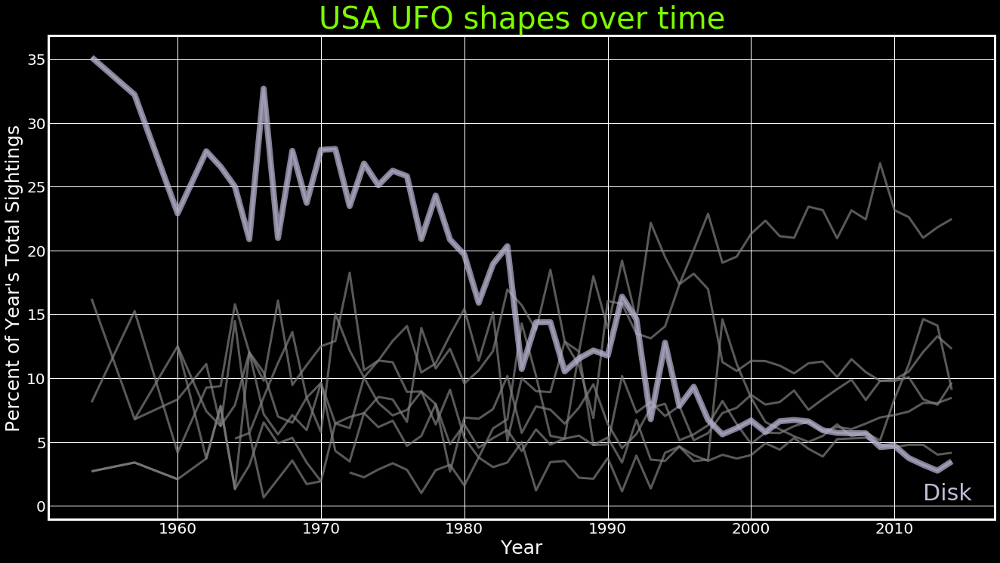

In [63]:
# create a color palette
palette = plt.get_cmap('Set3')
 
plt.style.use('dark_background')

# Sizing
fig, ax = plt.subplots(1, figsize=(20,11))    

# Style
plt.style.use('dark_background')

# Axis formatting
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(20)
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(20)    

# multiple line plot
num=0
for column in shape_pivot.columns:
    num+=1
    plt.plot(shape_pivot.index, shape_pivot[column], color='grey', 
            linewidth=3, alpha=0.7, label = column)

# Now re do the interesting curve, but biger with distinct color
plt.plot(shape_pivot.index, shape_pivot['disk'], marker='', color=palette(2), linewidth=8, alpha=0.7)

plt.text(2012, shape_pivot.disk.tail(1)-3, 'Disk', horizontalalignment='left',
         color=palette(2), fontsize=30)

# Add titles
plt.title("USA UFO shapes over time", loc='center', fontsize=40, fontweight=5, color='lawngreen')
plt.xlabel("Year", fontsize=25)
plt.ylabel("Percent of Year's Total Sightings", fontsize=25)

##### Emphasize 'Light'

Text(0, 0.5, "Percent of Year's Total Sightings")

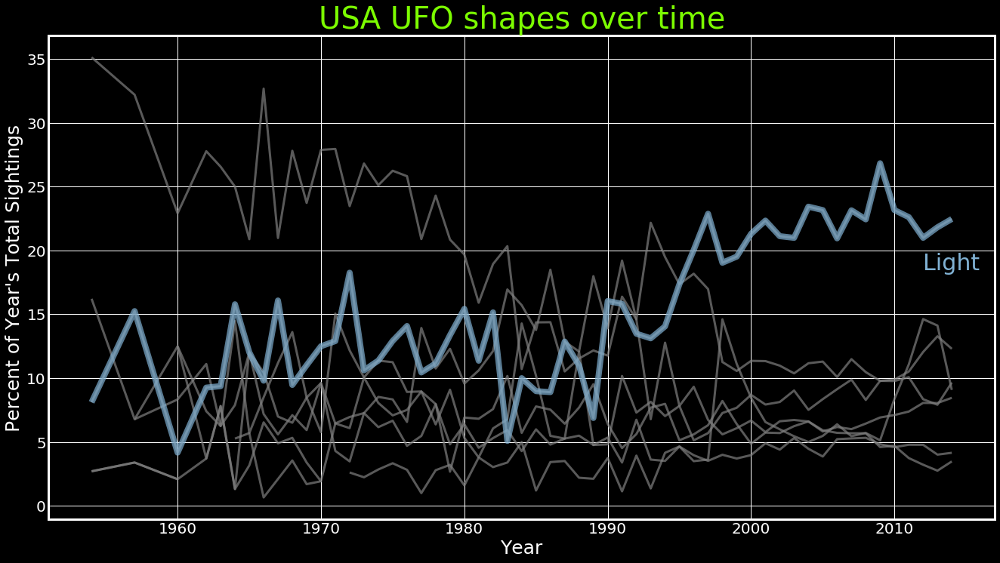

In [64]:
# create a color palette
palette = plt.get_cmap('Set3')
 
plt.style.use('dark_background')

# Sizing
fig, ax = plt.subplots(1, figsize=(20,11))    

# Style
plt.style.use('dark_background')

# Axis formatting
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(20)
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(20)    

# multiple line plot
num=0
for column in shape_pivot.columns:
    num+=1
    plt.plot(shape_pivot.index, shape_pivot[column], color='grey', 
            linewidth=3, alpha=0.7, label = column)

# Now re do the interesting curve, but biger with distinct color
plt.plot(shape_pivot.index, shape_pivot['light'], marker='', color=palette(4), linewidth=8, alpha=0.7)

plt.text(2012, shape_pivot.light.tail(1)-4, 'Light', horizontalalignment='left',
         color=palette(4), fontsize=30)

# Add titles
plt.title("USA UFO shapes over time", loc='center', fontsize=40, fontweight=5, color='lawngreen')
plt.xlabel("Year", fontsize=25)
plt.ylabel("Percent of Year's Total Sightings", fontsize=25)

##### Emphasize 'Triangle'

Text(0, 0.5, "Percent of Year's Total Sightings")

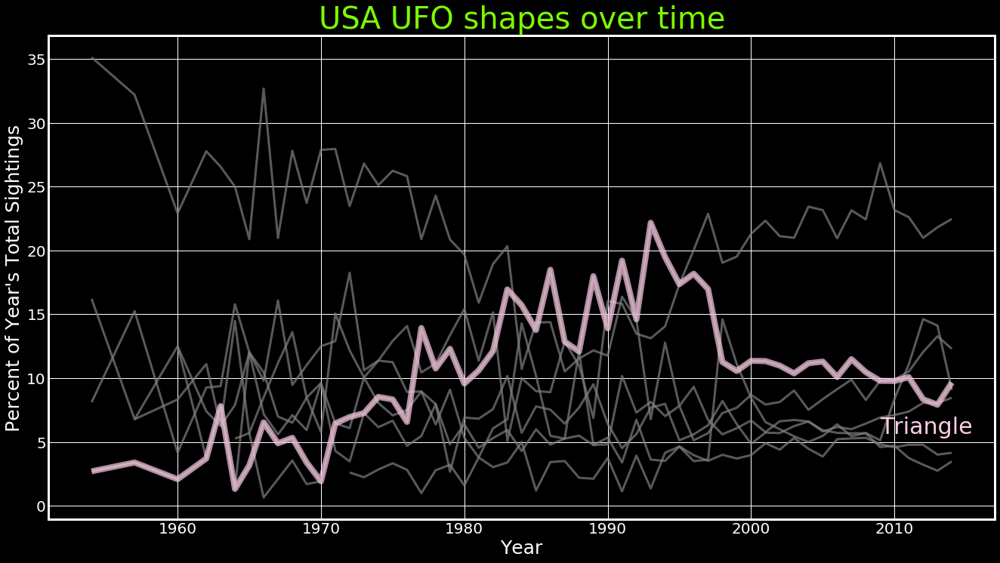

In [65]:
# create a color palette
palette = plt.get_cmap('Set3')
 
plt.style.use('dark_background')

# Sizing
fig, ax = plt.subplots(1, figsize=(20,11))    

# Style
plt.style.use('dark_background')

# Axis formatting
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(20)
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(20)    

# multiple line plot
num=0
for column in shape_pivot.columns:
    num+=1
    plt.plot(shape_pivot.index, shape_pivot[column], color='grey', 
            linewidth=3, alpha=0.7, label = column)

# Now re do the interesting curve, but biger with distinct color
plt.plot(shape_pivot.index, shape_pivot['triangle'], marker='', color=palette(7), linewidth=8, alpha=0.7)

plt.text(2009, shape_pivot.triangle.tail(1)-4, 'Triangle', horizontalalignment='left',
         color=palette(7), fontsize=30)

# Add titles
plt.title("USA UFO shapes over time", loc='center', fontsize=40, fontweight=5, color='lawngreen')
plt.xlabel("Year", fontsize=25)
plt.ylabel("Percent of Year's Total Sightings", fontsize=25)

### Visualization 7
### Common Words in UFO Sighting Descriptions
This visualization shows the common words in US UFO sightings

In [70]:
# select all US data
us_ufos_raw = ufos_raw[ufos_raw['country']=='us']
# ensure that all descriptions are string
us_ufos_raw['description'] = [str(desc) for desc in us_ufos_raw['description']]

In [71]:
# concatenate all the descriptions of UFO sighting
us_all_desc = ''.join(us_ufos_raw.description.values.tolist())

In [77]:
import spacy
from spacy.lang.en.stop_words import STOP_WORDS
import re
from collections import Counter
%matplotlib inline
import matplotlib.pyplot as plt
#fig = plt.figure()
plt.style.use('ggplot')  # makes prettier plots

# empty list to store common words
words_quantity_all_decades = []
common_words_all_decades = []

# text analysis
nlp = spacy.load('en', disable=['ner', 'parser', 'tagger'])
nlp.max_length = 1000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000

corpus_text = us_all_desc
doc = nlp(corpus_text)

histogram = Counter()
for token in doc:
    if token.is_stop == False:# exclude the stop words
        lemma = token.lemma_
        if re.match('[a-zA-Z]+$', lemma):# exclude special symbols
            histogram[lemma.lower()] += 1

# convert histogram into two lists `lemmas_unsorted` and `counts_unsorted`
# where the i-th lemma in `lemmas_unsorted` has raw counts given by `counts_unsorted[i]`
lemmas_unsorted = []
counts_unsorted = []
for lemma, count in histogram.items():
    lemmas_unsorted.append(lemma)
    counts_unsorted.append(count)
counts_unsorted = np.array(counts_unsorted)

# compute the indices that would sort the list 
# `counts_unsorted` in decreasing order
sort_indices = np.argsort(counts_unsorted)[::-1]
sorted_counts = counts_unsorted[sort_indices]
    
# store 30 most common words into the empty list
for rank, idx in enumerate(sort_indices[:30]):
    words_quantity_all_decades.append(counts_unsorted[idx])
    common_words_all_decades.append(lemmas_unsorted[idx])


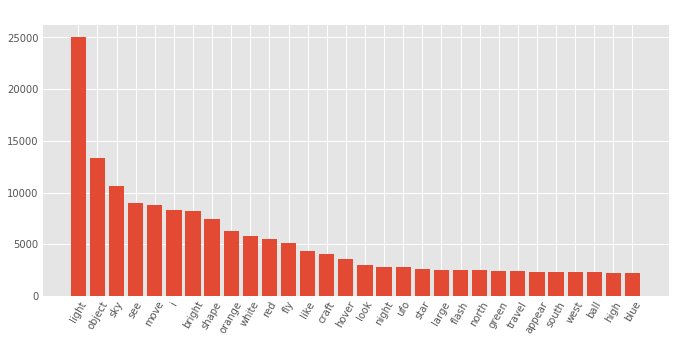

In [78]:
# plot a bar chart
plt.figure(figsize=(10, 5))
plt.title('Most Common Words in UFO Description')
plt.bar(common_words_all_decades,height=words_quantity_all_decades)
plt.xticks(rotation=60) 
plt.show()

The above visualization shows the common words in UFO description among all yeas. We'd like to see wether the common words change over years. The following charts show this.
Besides, common words including 'I','object' and 'UFO' have low explanatory power for UFO description changes, so we remove those words.

In [79]:
# concatenate all the descriptions of UFO sighting in same decade
us_df_decades = []
for i in range(len(decades)):
    us_df_decades.append(us_ufos_raw[us_ufos_raw['decade'].isin([decades[i]])])
us_desc_decades = [' '.join(df.description.values.tolist())
                   .replace(' I','').replace(' object','')
                   .replace(' UFO','') for df in us_df_decades]
us_desc_decades[2]

'Young boy witnesses disc in sky abovellinois farmland in December 1925. ((NUFORC Note:  Probable hoax.  Note date.  PD))  Strange gathering ofs in the sky. we were traveling east of burns&#44clmbing up thru a cut in the rim rocks when this very slowely flew over the top of us&#44 some 50 f'


 ----- 1900 -----
Rank  Lemma      Raw Count

 ----- 1910 -----
Rank  Lemma      Raw Count
1     east       1
2     west       1
3     move       1
4     shape      1
5     cigar      1
6     missouri   1
7     northern   1
8     sight      1
9     historical 1

 ----- 1920 -----
Rank  Lemma      Raw Count
1     sky        2
2     note       2
3     f          1
4     hoax       1
5     boy        1
6     witness    1
7     disc       1
8     abovellinois 1
9     farmland   1
10    december   1
11    nuforc     1
12    probable   1
13    date       1
14    fly        1
15    pd         1
16    strange    1
17    gather     1
18    ofs        1
19    travel     1
20    east       1

 ----- 1930 -----
Rank  Lemma      Raw Count
1     two        2
2     light      2
3     high       2
4     mother     2
5     see        2
6     move       2
7     grind      1
8     student    1
9     school     1
10    slow       1
11    beca       1
12    year       1
13    tell       1
14    they      

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

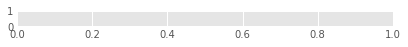

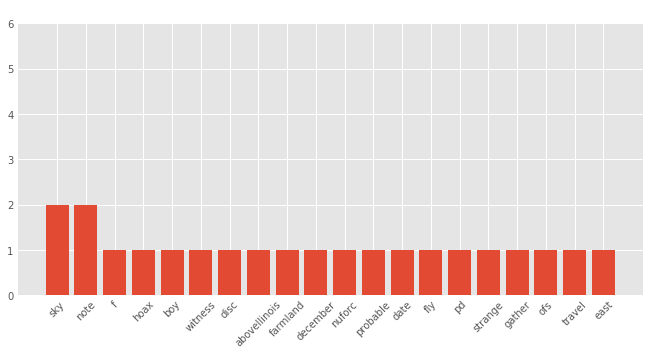

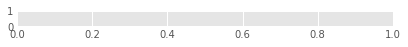

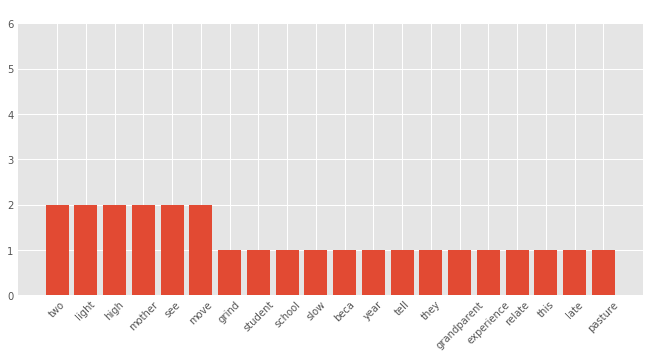

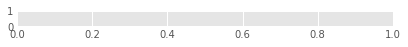

...

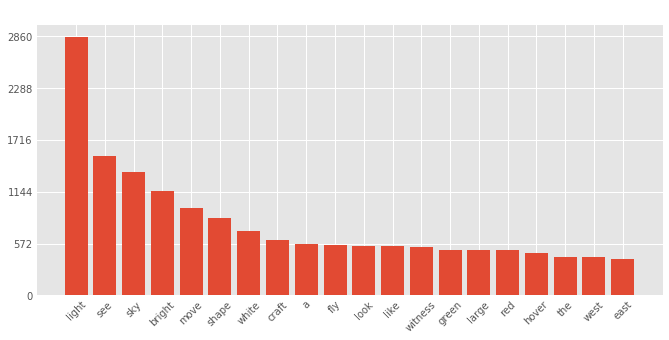

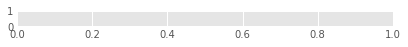

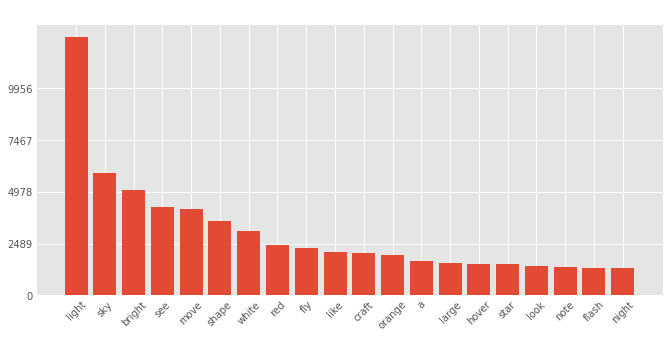

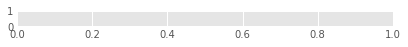

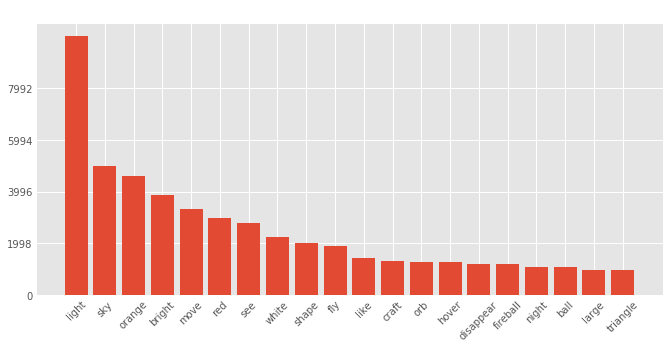

In [80]:
import spacy
from spacy.lang.en.stop_words import STOP_WORDS
import re
from collections import Counter
%matplotlib inline
import matplotlib.pyplot as plt
#fig = plt.figure()
plt.style.use('ggplot')  # makes prettier plots

# empty list to store common words in each year
common_words = [[] for i in range(len(us_desc_decades))]
words_quantity = [[] for i in range(len(us_desc_decades))]

# text analysis
nlp = spacy.load('en', disable=['ner', 'parser', 'tagger'])
nlp.max_length = 1000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000

for i in range(len(us_desc_decades)):
    corpus_text = us_desc_decades[i]
    doc = nlp(corpus_text)

    histogram = Counter()
    for token in doc:
        if token.is_stop == False:# exclude the stop words
            lemma = token.lemma_
            if re.match('[a-zA-Z]+$', lemma):# exclude special symbols
                histogram[lemma.lower()] += 1

    # convert histogram into two lists
    # `lemmas_unsorted` and `counts_unsorted`
    # where the i-th lemma in `lemmas_unsorted` 
    # has raw counts given by `counts_unsorted[i]`
    lemmas_unsorted = []
    counts_unsorted = []
    for lemma, count in histogram.items():
        lemmas_unsorted.append(lemma)
        counts_unsorted.append(count)
    counts_unsorted = np.array(counts_unsorted)

    # compute the indices that would sort the list 
    # `counts_unsorted` in decreasing order
    sort_indices = np.argsort(counts_unsorted)[::-1]
    sorted_counts = counts_unsorted[sort_indices]
    
    # print the word counts
    # and store the common words into the empty list
    print('\n','-----',decades[i],'-----')
    print('Rank'.ljust(5), 'Lemma'.ljust(10), 'Raw Count')
    for rank, idx in enumerate(sort_indices[:20]):
        words_quantity[i].append(counts_unsorted[idx])
        common_words[i].append(lemmas_unsorted[idx])
        print(str(rank + 1).ljust(5), 
              lemmas_unsorted[idx].ljust(10), counts_unsorted[idx])
    
    # plot bar graph
    fig = plt.figure()
    if len(sorted_counts) >= 20: # don't plot if there are too few words
        ax = fig.add_subplot(len(decades),1,i+1)
        fig,ax = plt.subplots(figsize=(10,5))
        ax.bar(common_words[i], height=sorted_counts[:20])
        # set x axis, y axis and title
        ax.set_xticklabels(common_words[i],rotation=45)
        ax.set_title(decades[i])
        ax.set_yticks(np.arange(0,sorted_counts.max()+5,
                                (sorted_counts.max()+5)//5))
    
# plt.show()


In [81]:
# show the most common words in a dataframe
common_words[1].append('')
common_words[1].append('')
df_common_words = pd.DataFrame(
    data=[i[:10] for i in common_words[2:]],
    index=decades[2:],
    columns=[i+1 for i in range(10)])

df_common_words

,1,2,3,4,5,6,7,8,9,10
1920,sky,note,f,hoax,boy,witness,disc,abovellinois,farmland,december
1930,two,light,high,mother,see,move,grind,student,school,slow
1940,the,disk,see,sky,a,craft,light,silver,look,early
1950,see,light,shape,sky,saucer,move,fly,the,a,hover
1960,light,see,shape,sky,hover,craft,bright,move,large,a
1970,light,see,shape,craft,sky,hover,move,bright,large,fly
1980,light,shape,see,craft,move,sky,large,hover,bright,a
1990,light,see,sky,bright,move,shape,white,craft,a,fly
2000,light,sky,bright,see,move,shape,white,red,fly,like
2010,light,sky,orange,bright,move,red,see,white,shape,fly


In [82]:
# show the rest common words in a dataframe
df_rest_common_words = pd.DataFrame(
    data=[i[10:] for i in common_words[2:]],
    index=decades[2:],
    columns=[i+11 for i in range(10)])

df_rest_common_words

,11,12,13,14,15,16,17,18,19,20
1920,nuforc,probable,date,fly,pd,strange,gather,ofs,travel,east
1930,beca,year,tell,they,grandparent,experience,relate,this,late,pasture
1940,shape,round,white,sight,like,and,hover,july,large,ball
1950,craft,disk,star,sight,white,my,cigar,silver,formation,disc
1960,sight,fly,saucer,like,white,disk,the,night,color,red
1970,saucer,a,the,night,like,white,look,red,sight,foot
1980,fly,the,white,like,night,red,look,triangle,sight,sound
1990,look,like,witness,green,large,red,hover,the,west,east
2000,craft,orange,a,large,hover,star,look,note,flash,night
2010,like,craft,orb,hover,disappear,fireball,night,ball,large,triangle
